In [1]:
%matplotlib inline

#debug code
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append("..")

import tensorflow as tf
import lucid
import numpy as np
import atari_zoo
from atari_zoo import MakeAtariModel
from atari_zoo.rollout import generate_rollout

from lucid.misc.io import show
import lucid.optvis.objectives as objectives
import lucid.optvis.param as param
import lucid.optvis.transform as transform
import lucid.optvis.render as render

from atari_zoo import game_list


/home/joel.lehman/code/rl_base/env/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


pygame 1.9.4
Hello from the pygame community. https://www.pygame.org/contribute.html


## Basic Walkthrough of Atari Zoo features

This notebook shows how to load in models, generate and view rollout data, and generate videos.

## Setup

In [3]:
#currently supported algorithms
algos = ['a2c','es','ga','apex','rainbow','dqn']

algo = algos[3] # which algorithm
env = "SeaquestNoFrameskip-v4" #game_list[0] # which gym environment
run_id = 2 # which run?
tag = 'final' # which checkpoint?

print('Algorithm: {} Environment: {} Run Id: {} Tag: {}'.format(algo,env,run_id,tag))

Algorithm: apex Environment: SeaquestNoFrameskip-v4 Run Id: 2 Tag: final


## Getting frames, observations, and RAM states

In [4]:
#load model
m = MakeAtariModel(algo,env,run_id,tag=tag)()

#load in graphdef & graph
m.load_graphdef()
m.import_graph()

#save the model to onnx -- why not?
#atari_zoo.utils.to_onnx(m,"a2c.onnx")

Model path: https://dgqeqexrlnkvd.cloudfront.net/zoo/apex/SeaquestNoFrameskip-v4/model2_final.pb


## Generate a short rollout directly (i.e. simluating in atari)

Note: requires OpenAI gym to be installed with Atari extension

In [5]:
from timeit import default_timer as timer

start = timer()
results = generate_rollout(m,min_frames=500,max_frames=500)
end=timer()
print(end-start)

  warnings.warn('DEPRECATION WARNING: to improve load times, gym no longer automatically loads gym.spaces. Please run "import gym.spaces" to load gym.spaces on your own. This warning will turn into an error in a future version of gym.')



WARN: gym.spaces.Box autodetected dtype as <class 'numpy.uint8'>. Please provide explicit dtype.
WARN: gym.spaces.Box autodetected dtype as <class 'numpy.uint8'>. Please provide explicit dtype.
WARN: <class 'atari_zoo.atari_wrappers.FrameStack'> doesn't implement 'reset' method, but it implements deprecated '_reset' method.
6.196966502815485


Episode rewards: [1820.    0.]


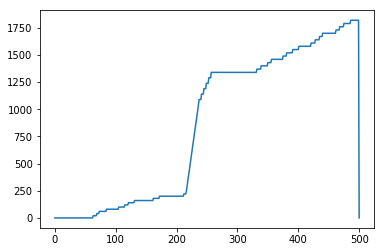

In [6]:
#grab results data 
obs = np.array(results['observations'])
frames = np.array(results['frames'])
ram = np.array(results['ram'])
scores = np.array(results['score'])
rep = np.array(results['representation'])

#note that the reward for the last episode is likely incomplete
episode_rewards = np.array(results['ep_rewards'])

print('Episode rewards:',episode_rewards)

obs_idx = 300

from pylab import *
plot(scores)

## Or get rollout directly from precomputed cache 

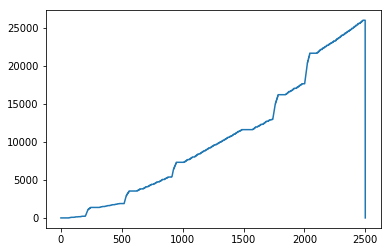

In [7]:
obs = m.get_observations()
frames = m.get_frames()
ram = m.get_ram()
scores = m.get_scores()
rep = m.get_representation()
episode_rewards = m.get_episode_rewards()

#particular observation we'll pay attention to
obs_idx = 1900

from pylab import *
plot(scores)

The precipitous drops in score are when one episode ends and another begins

## Converting from integers to binary RAM states

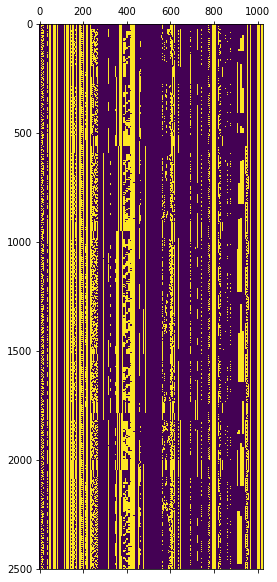

In [8]:
from pylab import *

ram = np.array(ram)
#get ram state across all frames of the observation
bin_array = np.zeros((ram.shape[0],128*8),dtype=np.uint8)

#convert from integer to bits
for idx in range(ram.shape[0]):
    state = ram[idx]
    
    binary = m.ram_state_to_bits(state)
    binary = [int(k) for k in binary]
    
    bin_array[idx]=binary
    
matshow(bin_array)

X-axis is the 1024 bits of Atari Ram, Y-axis is the 2500 frames of the rollout. The image shows how the Atari RAM is changing over the rollout.

## Visualize observations

<Figure size 432x288 with 0 Axes>

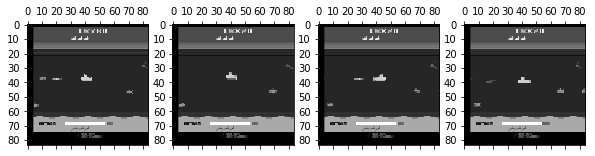

In [9]:
from pylab import *
gray()
figure(figsize=(10,4))
for x in range(4):
    subplot(141+x)
    matshow(obs[obs_idx,:,:,x],fignum=0)
    
#subplot(155)
#imshow(frames[obs_idx])

Observations are provided to the neural network as a stack of the four most recent gray-scaled frames

## Visualize frames

(2501, 210, 160, 3)

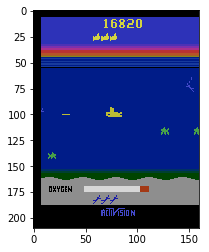

In [10]:
imshow(frames[obs_idx])
frames.shape

Here's the RGB frame

## Get high-level representation for an input observation

We can also get the neural network's high level representation for a given input. Here we treat the fully-connected layer (i.e. the penultimate layer fo the network) as the network's representation of a given state.

In [11]:
import atari_zoo.utils
#import importlib
#importlib.reload(atari_zoo.utils)
from atari_zoo.utils import conv_activations_to_canvas
from atari_zoo.utils import fc_activations_to_canvas

from lucid.optvis.render import import_model

#get a tf session
session = atari_zoo.utils.get_session()

#create a placeholder input to the network
X_t = tf.placeholder(tf.float32, [None] + m.image_shape)

#now get access to a dictionary that grabs output layers from the model
T = import_model(m,X_t,X_t)

#print(session.graph.get_operations())

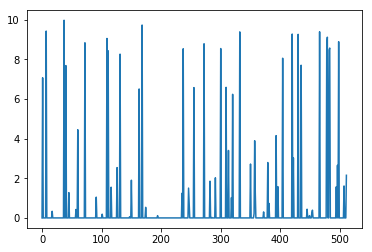

In [12]:
from pylab import *

rep_layer = m.layers[-2]['name'] #second-to-last-layer (representation layer)
rep_layer_T = T(rep_layer)

rep = session.run(rep_layer_T,{X_t:obs[104:105]})
plot(rep[0])
show()

There are 512 neurons in the fully connected layer, here we are visualizing their activation for one particular observation

## Grab all activations

We can also grab all the activations of all neurons, and then visualize them

In [13]:
obs_idx = 145

(1, 4, 84, 84)


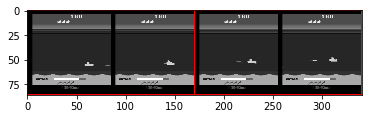

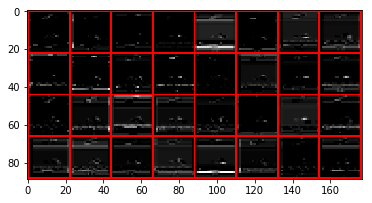

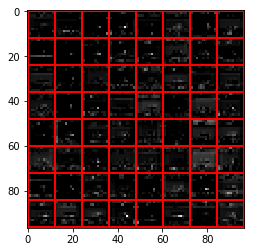

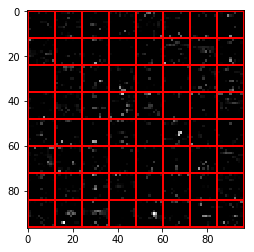

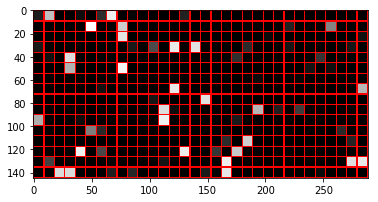

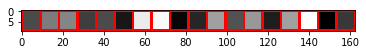

In [14]:
activations = [T(layer['name']) for layer in m.layers]

rep = session.run(activations,{X_t:obs[obs_idx:obs_idx+1]})

representation_names = [layer['name'] for layer in m.layers]

#make sure we represent activations the same across different models
n_obs = m.native_activation_representation(obs[obs_idx:obs_idx+1])
print(n_obs.shape)
rep.insert(0,n_obs)

#let's also visualize the input observations
representation_names.insert(0,'input')
representation_shapes = [array.shape for array in rep]

#loop through all the layers and visualize the activations
for rep_idx in range(len(rep)):
    name = representation_names[rep_idx]
    shape = representation_shapes[rep_idx]
    #print(name,shape)
    if(len(shape)==4):
        canvas = conv_activations_to_canvas(m,rep[rep_idx],padding=1)
    elif(len(shape)==2):
        canvas = fc_activations_to_canvas(m,rep[rep_idx],padding=1)        
    figure()
    imshow(canvas)

## Examine particular activation map

(1, 4, 84, 84)
(1, 32, 21, 21)
(1, 64, 11, 11)
(1, 64, 11, 11)
(1, 512)
(1, 18)


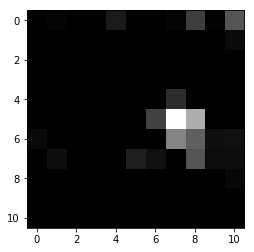

In [20]:
for _rep in rep:
    print(_rep.shape)
    
imshow(rep[3][0,60])

## Make activation movie

We can also make movies that allow us to simulataneously visualize the behavior of the agent and its neural activations, hopefully to give us some insight into what high-level features it is learning.

In [3]:
algo = 'apex'
env = 'SeaquestNoFrameskip-v4'
run_id = 1
tag = 'final'

#load model
m = MakeAtariModel(algo,env,run_id,tag=tag)()

#load in graphdef & graph
m.load_graphdef()
m.import_graph()

#mport importlib
#mportlib.reload(atari_zoo.activation_movie)
from atari_zoo.activation_movie import MakeActivationVideo

cc = MakeActivationVideo(m)
cc.ipython_display()

Model path: https://dgqeqexrlnkvd.cloudfront.net/zoo/apex/SeaquestNoFrameskip-v4/model1_final.pb
deepq/q_func/convnet/Conv/Relu
deepq/q_func/convnet/Conv_1/Relu
deepq/q_func/convnet/Conv_2/Relu
deepq/q_func/state_value/Relu
deepq/q_func/q_values


100%|██████████| 2501/2501 [00:47<00:00, 53.04it/s]


In [15]:
cc.write_videofile("activation_movie.mp4",bitrate="10M")

[MoviePy] >>>> Building video activation_movie.mp4
[MoviePy] Writing video activation_movie.mp4


100%|██████████| 2501/2501 [00:49<00:00, 50.12it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: activation_movie.mp4 



## Make conv3 centric activation movie

In [10]:
import atari_zoo
algo = 'apex'
env = 'SeaquestNoFrameskip-v4'
run_id = 1
tag = 'final'

from atari_zoo.activation_movie import MakeActivationVideoOneLayer
cc = MakeActivationVideoOneLayer(m,layer_no=2)
cc.ipython_display()

deepq/q_func/convnet/Conv/Relu
deepq/q_func/convnet/Conv_1/Relu
deepq/q_func/convnet/Conv_2/Relu
deepq/q_func/state_value/Relu
deepq/q_func/q_values


100%|██████████| 2501/2501 [00:04<00:00, 506.33it/s]


## Look at what image patches maximally activate certain neurons

In [3]:
import atari_zoo.top_patches
algo = 'apex'
env = 'SeaquestNoFrameskip-v4' 
run_id = 2
observations, activations,frames = atari_zoo.top_patches.build_model_get_act(algo, env, run_id=run_id,which_layer=2)

Model path: https://dgqeqexrlnkvd.cloudfront.net/zoo/apex/SeaquestNoFrameskip-v4/model2_final.pb
Data path: https://dgqeqexrlnkvd.cloudfront.net/zoo/apex/SeaquestNoFrameskip-v4/model2_final_rollout.npz
Log path: https://dgqeqexrlnkvd.cloudfront.net/zoo/apex/checkpoints/SeaquestNoFrameskip-v4_2
Layer 2 deepq/q_func/convnet/Conv_2/Relu activations obtained. Shape (2501, 11, 11, 64)


In [4]:
#sub detector for apex run 2 Seaquest is feature 60
filter_id = 60

patches, picks, topleft = atari_zoo.top_patches.plot_topN_patches(activations, observations, which_filter=filter_id, which_layer=2,n=40,plot=False)

bottom left location in original obs: (66,22)
bottom left location in original obs: (66,30)
bottom left location in original obs: (66,30)
bottom left location in original obs: (50,-2)
bottom left location in original obs: (50,30)
bottom left location in original obs: (66,30)
bottom left location in original obs: (58,22)
bottom left location in original obs: (74,30)
bottom left location in original obs: (58,38)
bottom left location in original obs: (58,38)
bottom left location in original obs: (58,22)
bottom left location in original obs: (58,46)
bottom left location in original obs: (58,38)
bottom left location in original obs: (50,30)
bottom left location in original obs: (58,38)
bottom left location in original obs: (66,22)
bottom left location in original obs: (58,38)
bottom left location in original obs: (42,-2)
bottom left location in original obs: (58,30)
bottom left location in original obs: (42,38)
bottom left location in original obs: (58,38)
bottom left location in original o

  max_open_warning, RuntimeWarning)



<Figure size 432x288 with 0 Axes>

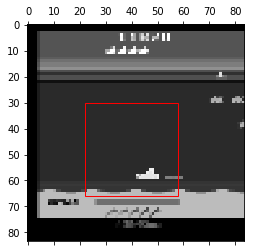

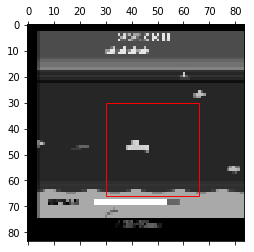

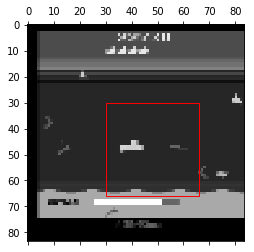

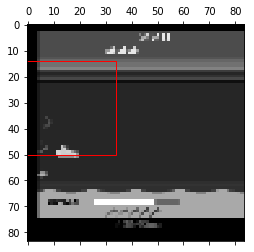

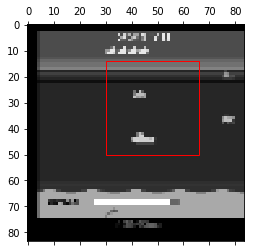

...

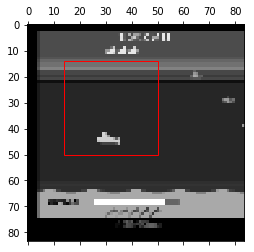

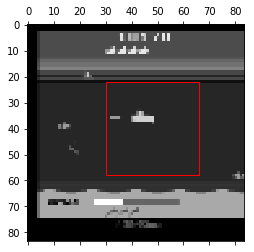

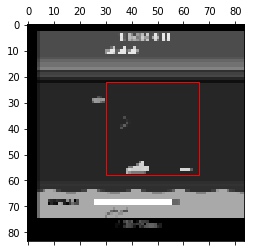

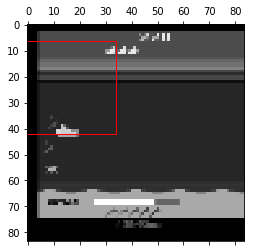

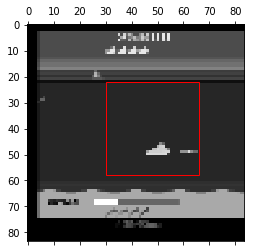

In [5]:
import matplotlib.patches as patches
from pylab import *

for pp, tl in zip(picks, topleft):
    #print(tl)
    #print(tuple(reversed(tl)))
    gray()
    fig, ax = subplots(1)
    ax.matshow(observations[pp,:,:,0])
    rect = patches.Rectangle(tuple(reversed(tl)),36,36,linewidth=1,edgecolor='r',facecolor='none')
    ax.add_patch(rect)
